In [25]:
from corm import model
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline
from scipy.stats.mstats import spearmanr

In [18]:
os.chdir('/Users/Erin/git/COX2/results/')
params = 10**np.loadtxt('CORM_parameter_sets.csv', delimiter=',', skiprows=1)
os.chdir('/Users/Erin/git/accre_data_analysis/corm/')
youts = np.loadtxt('CORM_simulations_init0.50.5_10sec.csv', delimiter=',', skiprows=1)

In [10]:
kcat_params = [0, 1, 9]

In [26]:
spearman_corr = np.zeros((len(params[0]), len(youts[0])))

In [39]:
for i in range(len(params[0])):
    for j in range(len(youts[0])):
        corr, pval = spearmanr(np.log10(params[:,i]), np.log10(youts[:,j]))
        spearman_corr[i][j] = corr

In [45]:
np.where(spearman_corr > .7)

(array([ 0,  2,  3,  4,  7,  7,  7,  7,  7,  8,  9, 10, 11]),
 array([12,  7,  8, 12,  0,  2,  5,  6, 11,  9,  9,  7,  8]))

In [44]:
np.where(spearman_corr < -.7)

(array([0, 4, 5, 6, 7, 8, 9]), array([ 9,  9,  8,  7, 10, 12, 12]))

In [46]:
spearman_corr[:,0]

array([ -3.77984494e-03,  -1.49689029e-02,  -9.25608111e-02,
         2.84856124e-04,   9.74233835e-02,  -2.72398744e-04,
         1.57851252e-01,   7.57089597e-01,   3.44968491e-01,
        -1.12596179e-01,  -5.43759375e-02,   4.16059564e-02])

In [11]:
def convert_microM_to_molecules(concentration, volume):
    #Concentration in microM and volume in microL
    micromol_per_microliter = concentration/1e6
    micromol_in_volume = micromol_per_microliter * volume
    moles = micromol_in_volume/1e6
    molecules = moles*6.022e23
    return molecules

In [21]:
molecular_params = np.zeros(np.shape(params))
molecular_params[:, kcat_params] = params[:, kcat_params]
for ip in range(len(params[0])):
    if ip not in kcat_params:
        molecular_params[:,ip] = convert_microM_to_molecules(params[:,ip], 200)

In [22]:
molecular_youts = np.zeros(np.shape(youts))
for yout in range(len(youts[0])):
    molecular_youts[:,yout] = convert_microM_to_molecules(youts[:,yout], 200)

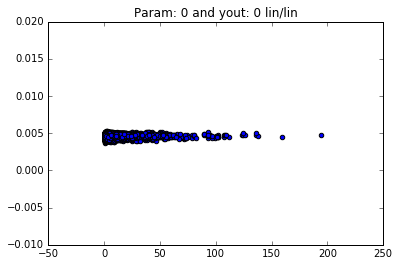

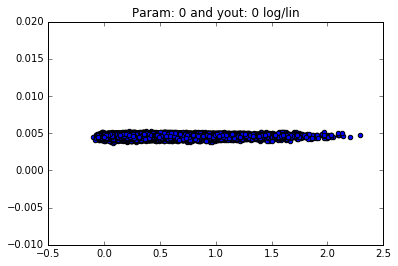

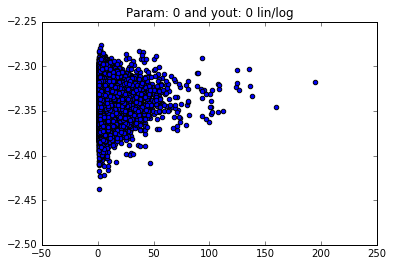

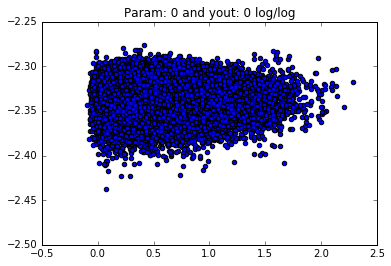

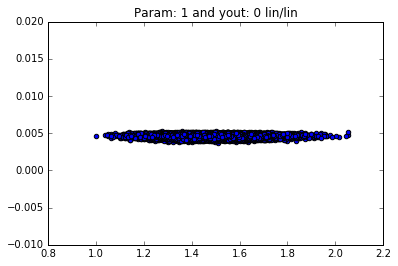

...

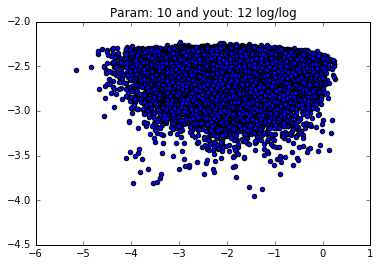

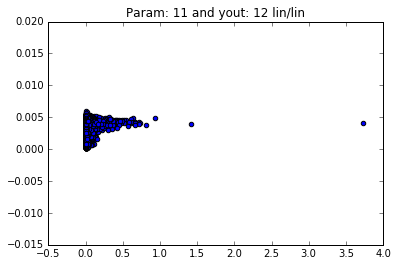

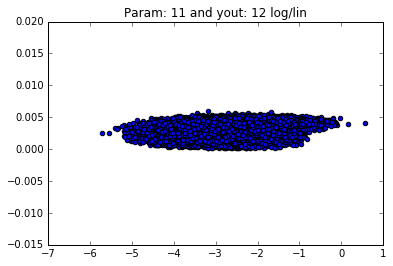

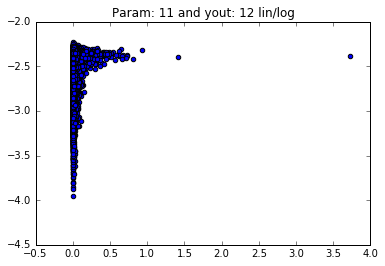

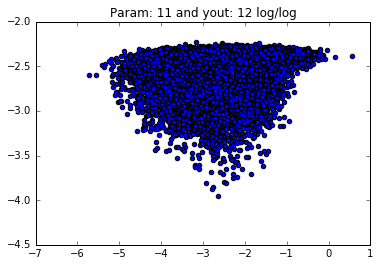

In [24]:
for yout in range(len(youts[0])):
    for param in range(len(params[0])):
        plt.figure()
        plt.scatter(params[:,param], youts[:,yout])
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' lin/lin')
        plt.figure()
        plt.scatter(np.log10(params[:,param]), youts[:,yout])
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' log/lin')
        plt.figure()
        plt.scatter(params[:,param], np.log10(youts[:,yout]))
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' lin/log')
        plt.figure()
        plt.scatter(np.log10(params[:,param]), np.log10(youts[:,yout]))
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' log/log')

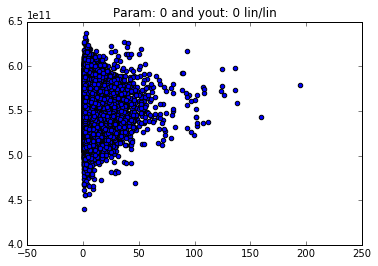

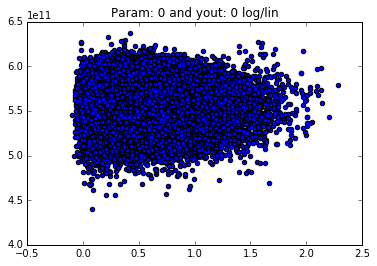

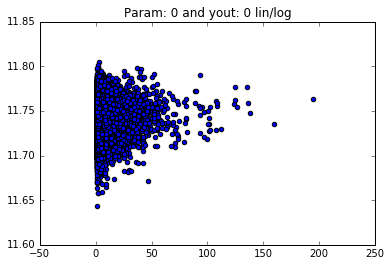

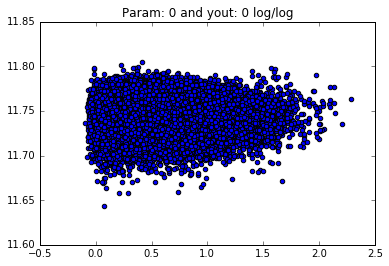

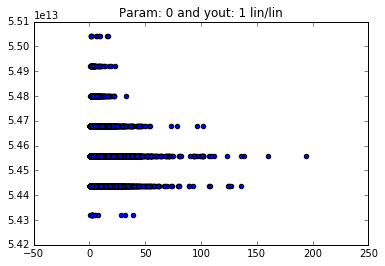

...

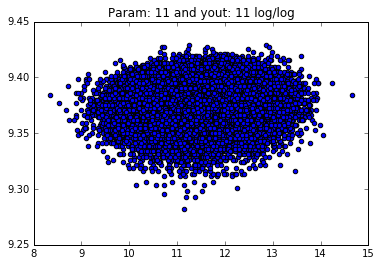

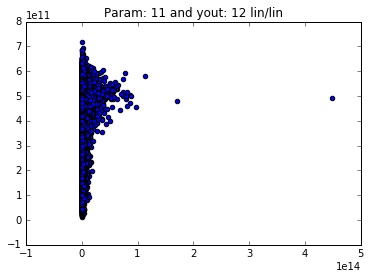

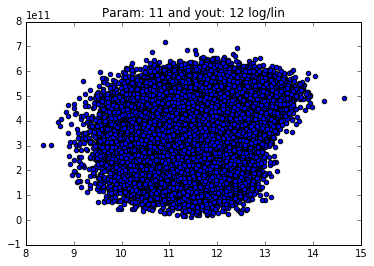

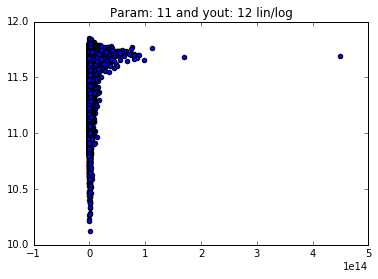

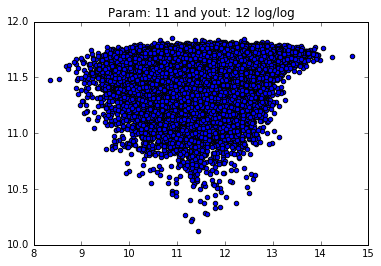

In [23]:
for param in range(len(params[0])):
    for yout in range(len(youts[0])):
        plt.figure()
        plt.scatter(molecular_params[:,param], molecular_youts[:,yout])
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' lin/lin')
        plt.figure()
        plt.scatter(np.log10(molecular_params[:,param]), molecular_youts[:,yout])
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' log/lin')
        plt.figure()
        plt.scatter(molecular_params[:,param], np.log10(molecular_youts[:,yout]))
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' lin/log')
        plt.figure()
        plt.scatter(np.log10(molecular_params[:,param]), np.log10(molecular_youts[:,yout]))
        plt.title('Param: '+str(param)+' and yout: '+str(yout)+' log/log')